In [93]:
import os
import cv2
import numpy as np
from PIL import Image
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models
from torch.utils.data import Dataset, DataLoader
from torch.optim import AdamW
from torch.optim.lr_scheduler import CosineAnnealingWarmRestarts, ReduceLROnPlateau
from torch.cuda.amp import GradScaler, autocast
import albumentations as A
from albumentations.pytorch import ToTensorV2
from sklearn.metrics import precision_score, recall_score, roc_auc_score, f1_score, jaccard_score

In [94]:
print( torch.cuda.is_available() )

True


In [95]:
[torch.cuda.get_device_name(i) for i in range(torch.cuda.device_count())]


['GeForce GTX 1650']

In [ ]:
class COD10KDataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None, edge_aware=True):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transform = transform
        self.edge_aware = edge_aware
        self.images = sorted(os.listdir(image_dir))
        self.masks = sorted(os.listdir(mask_dir))
        
        # Validate dataset
        assert len(self.images) == len(self.masks), "Number of images and masks don't match"
        for img, msk in zip(self.images, self.masks):
            assert img.split('.')[0] == msk.split('.')[0], f"Mismatched image-mask pair: {img} vs {msk}"

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        image_path = os.path.join(self.image_dir, self.images[idx])
        mask_path = os.path.join(self.mask_dir, self.masks[idx])

        image = Image.open(image_path).convert("RGB")
        mask = Image.open(mask_path).convert("L")

        # Resize both image and mask
        target_size = (352, 352)
        image = image.resize(target_size, Image.BILINEAR)
        mask = mask.resize(target_size, Image.NEAREST)

        image = np.array(image)
        mask = np.array(mask, dtype=np.float32) / 255.0  # Normalize to [0,1]

        if self.edge_aware:
            edges = cv2.Canny((mask * 255).astype(np.uint8), 50, 150) / 255.0  # Normalize to [0,1]
    
        if self.transform:
            # print(f"Image shape: {image.shape}, Mask shape: {mask.shape}")
            if self.edge_aware:
                # print(f"Edge map shape before transform: {edges.shape}")
                augmented = self.transform(image=image, mask=mask, edges=edges)
                edges = augmented["edges"]
            else:
                augmented = self.transform(image=image, mask=mask)

            image = augmented["image"]
            mask = augmented["mask"]

        # Ensure PyTorch format: (C, H, W)
        mask = mask[None, ...]  # Add channel dimension

        if self.edge_aware:
            edges = edges[None, ...]  # Ensure (1, H, W)
            return image, mask, edges

        return image, mask



In [97]:
def get_train_transform():
    return A.Compose([
        A.Resize(352, 352),
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.3),
        A.ColorJitter(p=0.5),
        A.RandomGamma(gamma_limit=(80, 120), p=0.3),
        A.RandomToneCurve(scale=0.3, p=0.3),
        A.GaussNoise(var_limit=(10, 50), p=0.3),
        A.Normalize(
            mean=[0.485, 0.456, 0.406],
            std=[0.229, 0.224, 0.225],
            max_pixel_value=255.0
        ),
        ToTensorV2()
    ], additional_targets={'edges': 'mask'})

In [ ]:
from torch.utils.data import DataLoader
import albumentations as A
from albumentations.pytorch import ToTensorV2

# Define transforms
train_transform = get_train_transform()

# Training set
train_dataset = COD10KDataset(
    image_dir='/kaggle/input/military-camouflage-soldiers-dataset-mcs1k/dataset-splitM/Training/images',
    mask_dir='/kaggle/input/military-camouflage-soldiers-dataset-mcs1k/dataset-splitM/Training/GT',
    transform=train_transform
)

train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)


In [ ]:
def get_test_transform():
    return A.Compose([
        A.Resize(352, 352),
        A.Normalize(
            mean=[0.485, 0.456, 0.406],
            std=[0.229, 0.224, 0.225],
            max_pixel_value=255.0
        ),
        ToTensorV2()
    ], additional_targets={'edges': 'mask'})

In [ ]:
# Test Transform (no augmentation, just resizing and normalization)
test_transform = get_test_transform()

test_dataset = COD10KDataset(
    image_dir='/kaggle/input/military-camouflage-soldiers-dataset-mcs1k/dataset-splitM/Testing/images',
    mask_dir='/kaggle/input/military-camouflage-soldiers-dataset-mcs1k/dataset-splitM/Testing/GT',
    transform=test_transform
)

test_loader = DataLoader(test_dataset, batch_size=8, shuffle=False)


In [ ]:
from torch.utils.data import random_split

# Assume full training dataset
full_train_dataset = COD10KDataset(
    image_dir='/kaggle/input/military-camouflage-soldiers-dataset-mcs1k/dataset-splitM/Training/images',
    mask_dir='/kaggle/input/military-camouflage-soldiers-dataset-mcs1k/dataset-splitM/Training/GT',
    transform=train_transform
)

# Split sizes
val_split = 0.1
val_size = int(len(full_train_dataset) * val_split)
train_size = len(full_train_dataset) - val_size

train_dataset, val_dataset = random_split(full_train_dataset, [train_size, val_size])

# Update val_dataset's transform (remove augmentations)
val_dataset.dataset.transform = test_transform

# DataLoaders
train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=8, shuffle=False)


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models
import torch.optim as optim
from torch.optim.lr_scheduler import ReduceLROnPlateau

class DCM(nn.Module): #DCM
    def __init__(self, in_channels, dilation_factors=[1, 2, 4, 2, 1]):
        super(DCM, self).__init__()
        self.convs = nn.ModuleList([
            nn.Sequential(
                nn.Conv2d(in_channels, in_channels, kernel_size=3, padding=d, dilation=d),
                nn.GroupNorm(8, in_channels),
                nn.ReLU(inplace=True)
            ) for d in dilation_factors
        ])
        self.se = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(in_channels, in_channels//8, kernel_size=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels//8, in_channels, kernel_size=1),
            nn.Sigmoid()
        )
        self.final_conv = nn.Conv2d(in_channels, in_channels, kernel_size=1)
    def forward(self, x):
        residual = x
        for conv in self.convs:
            x = conv(x)
        se_weight = self.se(x)
        return self.final_conv(x * se_weight + residual)

class PAN(nn.Module): #PAN
    def __init__(self, in_channels):
        super(PAN, self).__init__()
        self.non_local = nn.Sequential(
            nn.Conv2d(in_channels, in_channels, kernel_size=1),
            nn.GroupNorm(8, in_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels, in_channels, kernel_size=1)
        )
        self.pixel_attention = nn.Sequential(
            nn.Conv2d(in_channels, 1, kernel_size=1),
            nn.Sigmoid()
        )

    def forward(self, x):
        non_local_out = self.non_local(x)
        pixel_attention = self.pixel_attention(non_local_out)
        return x * pixel_attention

class FAM(nn.Module): #FAM
    def __init__(self, low_channels, high_channels):
        super(FAM, self).__init__()
        self.channel_attention = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(high_channels, high_channels // 16, kernel_size=1),
            nn.ReLU(),
            nn.Conv2d(high_channels // 16, high_channels, kernel_size=1),
            nn.Sigmoid()
        )
        self.spatial_attention = nn.Sequential(
            nn.Conv2d(low_channels, 1, kernel_size=7, padding=3),
            nn.Sigmoid()
        )
        self.match_channels = nn.Conv2d(low_channels, high_channels, kernel_size=1)

    def forward(self, low, high):
        high = F.interpolate(high, size=low.shape[2:], mode='bilinear', align_corners=False)
        channel_attention = self.channel_attention(high)
        low_matched = self.match_channels(low)
        spatial_attention = self.spatial_attention(low)
        return low_matched * spatial_attention + high * channel_attention

class ReverseAttention(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(ReverseAttention, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels + 1, in_channels, 3, padding=1),
            nn.BatchNorm2d(in_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels, out_channels, 1)
        )

    def forward(self, x, pred):
        pred_resized = F.interpolate(pred, size=x.shape[2:], mode='bilinear', align_corners=False)
        ra = torch.sigmoid(pred_resized)
        ra = 1 - ra
        x = torch.cat((x, ra), dim=1)  # Concatenate along channel dim: B x (C+1) x H x W
        return self.conv(x)

class EdgeDetectionHead(nn.Module):
    def __init__(self, in_channels):
        super(EdgeDetectionHead, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, in_channels // 2, 3, padding=1),
            nn.BatchNorm2d(in_channels // 2),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels // 2, 1, 1)
        )

    def forward(self, x):
        return self.conv(x)

class BoundaryRefinementModule(nn.Module):
    def __init__(self, in_channels):
        super().__init__()
        self.conv1 = nn.Sequential(
            nn.Conv2d(in_channels, 64, 3, padding=1),
            nn.GroupNorm(8, 64),
            nn.ReLU(inplace=True)
        )
        self.conv2 = nn.Conv2d(64, in_channels, 1)
        
    def forward(self, x):
        residual = x
        x = self.conv1(x)
        x = self.conv2(x)
        return x + residual

class PPM(nn.Module):
    def __init__(self, in_channels, pool_sizes=[1, 2, 3, 6]):
        super(PPM, self).__init__()
        self.stages = nn.ModuleList([
            nn.Sequential(
                nn.AdaptiveAvgPool2d(size),
                nn.Conv2d(in_channels, in_channels // 4, kernel_size=1),
                nn.ReLU(inplace=True)
            ) for size in pool_sizes
        ])
        self.bottleneck = nn.Conv2d(in_channels + (in_channels // 4) * len(pool_sizes), in_channels, kernel_size=1)

    def forward(self, x):
        h, w = x.shape[2:]
        pooled = [F.interpolate(stage(x), size=(h, w), mode='bilinear', align_corners=False) for stage in self.stages]
        x = torch.cat([x] + pooled, dim=1)
        return self.bottleneck(x)

class CORANet(nn.Module):
    def __init__(self, backbone='resnet50', dropout_rate=0.2):
        super(CORANet, self).__init__()
        resnet = models.resnet50(weights=models.ResNet50_Weights.IMAGENET1K_V1)
        
        # Feature extraction
        self.layer0 = nn.Sequential(resnet.conv1, resnet.bn1, resnet.relu, resnet.maxpool)
        self.layer1 = resnet.layer1  # low-level
        self.layer2 = resnet.layer2
        self.layer3 = resnet.layer3
        self.layer4 = resnet.layer4  # high-level

        # Enhanced modules with dropout
        self.reduce_channels = nn.Conv2d(2048, 512, kernel_size=1)
        self.dropout1 = nn.Dropout2d(dropout_rate)  # First dropout
        self.cfam = DCM(512)
        self.ppm = PPM(512)
        self.dropout2 = nn.Dropout2d(dropout_rate)  # Second dropout
        self.gppm = PAN(512)
        self.cffm = FAM(256, 512)

        # Prediction heads
        self.intermediate_pred = nn.Conv2d(512, 1, kernel_size=1)
        self.reverse_attention = ReverseAttention(in_channels=256, out_channels=1)
        self.edge_head = EdgeDetectionHead(256)
        self.final_pred = nn.Conv2d(512, 1, kernel_size=1)
        
        # Boundary refinement
        self.boundary_refine = BoundaryRefinementModule(1)
        
        # Channel reduction
        self.reduce_for_ra = nn.Conv2d(512, 256, kernel_size=1)
        
        # Upsampling
        self.upsample = nn.Upsample(scale_factor=4, mode='bilinear', align_corners=False)

    def forward(self, x):
        # Feature extraction
        x0 = self.layer0(x)
        x1 = self.layer1(x0)  # low-level
        x2 = self.layer2(x1)
        x3 = self.layer3(x2)
        x4 = self.layer4(x3)  # high-level

        # Feature processing with dropout
        reduced = self.reduce_channels(x4)
        reduced = self.dropout1(reduced)  # Apply first dropout
        cfam_out = self.cfam(reduced)
        ppm_out = self.ppm(cfam_out)
        ppm_out = self.dropout2(ppm_out)  # Apply second dropout
        gppm_out = self.gppm(ppm_out)
        fused = self.cffm(x1, gppm_out)

        # Predictions
        intermediate_out = self.intermediate_pred(ppm_out)
        out = self.final_pred(fused)
        
        # Boundary refinement
        out_refined = self.boundary_refine(out)
        
        # Reverse attention and edge detection
        ra_input = self.reduce_for_ra(fused)
        ra_out = self.reverse_attention(ra_input, out_refined)
        edge_out = self.edge_head(x1)

        # Upsample all outputs
        out_refined = self.upsample(out_refined)
        ra_out = self.upsample(ra_out)
        edge_out = self.upsample(edge_out)
        intermediate_out = self.upsample(intermediate_out)

        return out_refined, ra_out, edge_out, intermediate_out

In [ ]:
import numpy as np
from sklearn.metrics import precision_score, recall_score

def calculate_s_measure(preds, masks, alpha=0.5):
    """
    Calculate S-measure (Sα) for the given predictions and masks.
    S-measure combines object-aware (So) and region-aware (Sr) assessments.
    
    Args:
        preds (numpy.ndarray): Predicted binary mask (0s and 1s).
        masks (numpy.ndarray): Ground truth binary mask (0s and 1s).
        alpha (float): Weighting factor (default: 0.5).
    
    Returns:
        float: S-measure score.
    """
    # Object-aware similarity (So)
    intersection = np.sum(preds * masks)
    union = np.sum(preds) + np.sum(masks) - intersection
    So = intersection / union if union != 0 else 0.0

    # Region-aware similarity (Sr)
    preds_mean = np.mean(preds)
    masks_mean = np.mean(masks)
    Sr = 1 - np.abs(preds_mean - masks_mean)

    # S-measure
    S_alpha = alpha * So + (1 - alpha) * Sr
    return S_alpha

def calculate_e_measure(preds, masks):
    """
    Calculate E-measure (Eϕ) for the given predictions and masks.
    E-measure evaluates both local and global similarity.
    
    Args:
        preds (numpy.ndarray): Predicted binary mask (0s and 1s).
        masks (numpy.ndarray): Ground truth binary mask (0s and 1s).
    
    Returns:
        float: E-measure score.
    """
    # Enhanced alignment matrix (ϕ)
    enhanced_matrix = np.abs(preds - masks)
    E_phi = 1 - np.mean(enhanced_matrix)
    return E_phi

def calculate_f_measure(preds, masks, beta=0.3):
    """
    Calculate F-measure (Fβ) for the given predictions and masks.
    F-measure balances precision and recall.
    
    Args:
        preds (numpy.ndarray): Predicted binary mask (0s and 1s).
        masks (numpy.ndarray): Ground truth binary mask (0s and 1s).
        beta (float): Weighting factor for precision and recall (default: 0.3).
    
    Returns:
        float: F-measure score.
    """
    # Flatten the 2D arrays into 1D arrays
    preds_flat = preds.flatten()
    masks_flat = masks.flatten()
    
    # Calculate precision and recall
    precision = precision_score(masks_flat, preds_flat)
    recall = recall_score(masks_flat, preds_flat)
    
    # Calculate F-measure
    F_beta = (1 + beta**2) * (precision * recall) / (beta**2 * precision + recall)
    return F_beta

def calculate_mae(preds, masks):
    """
    Calculate Mean Absolute Error (MAE) for the given predictions and masks.
    
    Args:
        preds (numpy.ndarray): Predicted binary mask (0s and 1s).
        masks (numpy.ndarray): Ground truth binary mask (0s and 1s).
    
    Returns:
        float: MAE score.
    """
    return np.mean(np.abs(preds - masks))

In [ ]:
def calculate_metrics(model, test_loader):
    model.eval()
    all_preds = []
    all_masks = []
    
    with torch.no_grad():
        for images, masks, _ in test_loader:
            images = images.cuda()
            masks = masks.cpu().numpy()
            
            seg_output, _, _, _ = model(images)
            preds = torch.sigmoid(seg_output).cpu().numpy()
            
            # Process masks and predictions
            if masks.ndim == 4 and masks.shape[1] == 1:
                masks = masks.squeeze(1)
            if preds.ndim == 4 and preds.shape[1] == 1:
                preds = preds.squeeze(1)
            
            binary_masks = (masks > 0.5).astype(float)
            binary_preds = (preds > 0.5).astype(float)
            
            all_preds.append(binary_preds)
            all_masks.append(binary_masks)
    
    # Concatenate all batches
    all_preds = np.concatenate(all_preds)
    all_masks = np.concatenate(all_masks)
    flat_preds = all_preds.flatten()
    flat_masks = all_masks.flatten()
    
    metrics = {
        'mIoU': jaccard_score(flat_masks, flat_preds),
        'F1': f1_score(flat_masks, flat_preds),
        'AUC': roc_auc_score(flat_masks, flat_preds),
        'S_measure': calculate_s_measure(all_preds, all_masks),
        'E_measure': calculate_e_measure(all_preds, all_masks),
        'F_measure': calculate_f_measure(all_preds, all_masks),
        'MAE': calculate_mae(all_preds, all_masks)
    }
    
    return metrics


In [ ]:
# Enhanced Loss Functions with size handling
def resize_to_target(pred, target):
    """Resize prediction to match target size"""
    if pred.size()[2:] != target.size()[2:]:
        pred = F.interpolate(pred, size=target.size()[2:], mode='bilinear', align_corners=False)
    return pred

def dice_loss(pred, target, smooth=1e-6):
    """Dice loss with automatic resizing"""
    pred = resize_to_target(pred, target)
    pred = torch.sigmoid(pred)
    target = (target > 0.5).float()
    
    intersection = (pred * target).sum()
    union = pred.sum() + target.sum()
    dice = (2. * intersection + smooth) / (union + smooth)
    return 1 - dice

def boundary_aware_loss(pred, target):
    """Loss that emphasizes boundary regions"""
    pred = resize_to_target(pred, target)
    target_boundary = F.max_pool2d(target, kernel_size=3, stride=1, padding=1) - \
                     F.avg_pool2d(target, kernel_size=3, stride=1, padding=1)
    bce = F.binary_cross_entropy_with_logits(pred, target, reduction='none')
    weighted_bce = (1 + 5 * target_boundary) * bce
    return weighted_bce.mean()

def enhanced_bce_dice_loss(pred, target):
    """Combined loss function with proper resizing"""
    pred = resize_to_target(pred, target)
    bce = F.binary_cross_entropy_with_logits(pred, target)
    dice = dice_loss(pred, target)
    boundary = boundary_aware_loss(pred, target)
    return bce + dice + 0.5*boundary

# Training function with dropout handling
def train_epoch(model, train_loader, optimizer, scaler, epoch, device='cuda'):
    model.train()
    total_loss = 0
    
    for batch_idx, (images, masks, edges) in enumerate(train_loader):
        images, masks, edges = images.to(device), masks.to(device), edges.to(device)
        
        optimizer.zero_grad()
        
        with torch.cuda.amp.autocast():
            out, ra_out, edge_out, inter_out = model(images)
            
            # Segmentation loss
            loss_seg = enhanced_bce_dice_loss(out, masks)
            
            # # Edge supervision loss
            # edge_loss = F.binary_cross_entropy_with_logits(
            #     resize_to_target(edge_out, edges),
            #     edges
            # )
            
            # # Intermediate output loss
            # inter_loss = enhanced_bce_dice_loss(inter_out, masks)
            
            # Combined loss
            loss = loss_seg  #loss = loss_seg + 0.5*edge_loss + 0.3*inter_loss
        
        scaler.scale(loss).backward()
        scaler.unscale_(optimizer)
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
        scaler.step(optimizer)
        scaler.update()
        
        total_loss += loss.item()
        
        if batch_idx % 50 == 0:
            print(f'Epoch {epoch} Batch {batch_idx}/{len(train_loader)} Loss: {loss.item():.4f}')
    
    return total_loss / len(train_loader)

# Validation function
@torch.no_grad()
def validate(model, val_loader, device='cuda'):
    model.eval()
    total_loss = 0
    
    for images, masks, edges in val_loader:
        images, masks, edges = images.to(device), masks.to(device), edges.to(device)
        
        with torch.cuda.amp.autocast():
            out, ra_out, edge_out, inter_out = model(images)
            
            loss_seg = enhanced_bce_dice_loss(out, masks)
            edge_loss = F.binary_cross_entropy_with_logits(
                resize_to_target(edge_out, edges),
                edges
            )
            inter_loss = enhanced_bce_dice_loss(inter_out, masks)
            
            loss = loss_seg + 0.5*edge_loss + 0.3*inter_loss
            total_loss += loss.item()
    
    return total_loss / len(val_loader)

In [ ]:
# Initialize with updated AMP syntax
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model = CORANet(dropout_rate=0.2).to(device)
optimizer = optim.AdamW(model.parameters(), lr=1e-5, weight_decay=1e-4)
scheduler = CosineAnnealingWarmRestarts(optimizer, T_0=10, T_mult=2)
scaler = GradScaler()

# Training loop
best_val_loss = float('inf')
patience = 6
epochs_no_improve = 0

for epoch in range(1, 101):
    print(f'\nEpoch {epoch}')
    
    # Train
    train_loss = train_epoch(model, train_loader, optimizer, scaler, epoch, device)
    
    # Validate
    val_loss = validate(model, val_loader, device)
    scheduler.step()
    
    print(f'Train Loss: {train_loss:.4f} | Val Loss: {val_loss:.4f}')
    
    # Check for improvement
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        epochs_no_improve = 0
        torch.save(model.state_dict(), 'best_model.pth')
        print('Model improved and saved!')
        
        # Evaluate on test set
        test_metrics = calculate_metrics(model, test_loader)
        print('\nTest Metrics:')
        for name, value in test_metrics.items():
            print(f'{name}: {value:.4f}')
    else:
        epochs_no_improve += 1
        print(f'No improvement ({epochs_no_improve}/{patience})')
        
        if epochs_no_improve >= patience:
            print('Early stopping triggered!')
            break

# Note: Make sure your calculate_metrics function also accepts device parameter


Epoch 1


<ipython-input-28-4ee9460c3afe>:46: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 1 Batch 0/85 Loss: 2.8431
Epoch 1 Batch 50/85 Loss: 2.0169


<ipython-input-28-4ee9460c3afe>:86: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Train Loss: 2.1580 | Val Loss: 1.6351
Model improved and saved!

Test Metrics:
mIoU: 0.4558
F1: 0.6262
AUC: 0.7423
S_measure: 0.6939
E_measure: 0.8769
F_measure: 0.7564
MAE: 0.1231

Epoch 2


<ipython-input-28-4ee9460c3afe>:46: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 2 Batch 0/85 Loss: 1.5592
Epoch 2 Batch 50/85 Loss: 1.2728


<ipython-input-28-4ee9460c3afe>:86: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Train Loss: 1.4130 | Val Loss: 1.2528
Model improved and saved!

Test Metrics:
mIoU: 0.5963
F1: 0.7471
AUC: 0.8420
S_measure: 0.7979
E_measure: 0.8996
F_measure: 0.7477
MAE: 0.1004

Epoch 3


<ipython-input-28-4ee9460c3afe>:46: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 3 Batch 0/85 Loss: 1.3390
Epoch 3 Batch 50/85 Loss: 1.2076


<ipython-input-28-4ee9460c3afe>:86: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Train Loss: 1.1664 | Val Loss: 1.1780
Model improved and saved!

Test Metrics:
mIoU: 0.6260
F1: 0.7700
AUC: 0.8615
S_measure: 0.8087
E_measure: 0.9066
F_measure: 0.7566
MAE: 0.0934

Epoch 4


<ipython-input-28-4ee9460c3afe>:46: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 4 Batch 0/85 Loss: 1.3641
Epoch 4 Batch 50/85 Loss: 1.0157


<ipython-input-28-4ee9460c3afe>:86: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Train Loss: 1.0511 | Val Loss: 1.1686
Model improved and saved!

Test Metrics:
mIoU: 0.6341
F1: 0.7761
AUC: 0.8515
S_measure: 0.8097
E_measure: 0.9143
F_measure: 0.8018
MAE: 0.0857

Epoch 5


<ipython-input-28-4ee9460c3afe>:46: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 5 Batch 0/85 Loss: 0.8579
Epoch 5 Batch 50/85 Loss: 1.0943


<ipython-input-28-4ee9460c3afe>:86: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Train Loss: 0.9667 | Val Loss: 1.1598
Model improved and saved!

Test Metrics:
mIoU: 0.6267
F1: 0.7705
AUC: 0.8449
S_measure: 0.8032
E_measure: 0.9135
F_measure: 0.8069
MAE: 0.0865

Epoch 6


<ipython-input-28-4ee9460c3afe>:46: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 6 Batch 0/85 Loss: 1.2396
Epoch 6 Batch 50/85 Loss: 0.8931


<ipython-input-28-4ee9460c3afe>:86: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Train Loss: 0.9196 | Val Loss: 1.1555
Model improved and saved!

Test Metrics:
mIoU: 0.6400
F1: 0.7805
AUC: 0.8494
S_measure: 0.8087
E_measure: 0.9178
F_measure: 0.8220
MAE: 0.0822

Epoch 7


<ipython-input-28-4ee9460c3afe>:46: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 7 Batch 0/85 Loss: 0.7863
Epoch 7 Batch 50/85 Loss: 0.9099


<ipython-input-28-4ee9460c3afe>:86: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Train Loss: 0.8810 | Val Loss: 1.1300
Model improved and saved!

Test Metrics:
mIoU: 0.6413
F1: 0.7815
AUC: 0.8527
S_measure: 0.8116
E_measure: 0.9171
F_measure: 0.8140
MAE: 0.0829

Epoch 8


<ipython-input-28-4ee9460c3afe>:46: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 8 Batch 0/85 Loss: 0.8120
Epoch 8 Batch 50/85 Loss: 0.8430


<ipython-input-28-4ee9460c3afe>:86: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Train Loss: 0.8546 | Val Loss: 1.1598
No improvement (1/6)

Epoch 9
Epoch 9 Batch 0/85 Loss: 0.8750
Epoch 9 Batch 50/85 Loss: 0.9138
Train Loss: 0.8618 | Val Loss: 1.1566
No improvement (2/6)

Epoch 10
Epoch 10 Batch 0/85 Loss: 0.9494
Epoch 10 Batch 50/85 Loss: 0.8732
Train Loss: 0.8305 | Val Loss: 1.1135
Model improved and saved!

Test Metrics:
mIoU: 0.6397
F1: 0.7803
AUC: 0.8550
S_measure: 0.8133
E_measure: 0.9156
F_measure: 0.8033
MAE: 0.0844

Epoch 11


<ipython-input-28-4ee9460c3afe>:46: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 11 Batch 0/85 Loss: 0.7895
Epoch 11 Batch 50/85 Loss: 0.8192


<ipython-input-28-4ee9460c3afe>:86: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Train Loss: 0.8484 | Val Loss: 1.0840
Model improved and saved!

Test Metrics:
mIoU: 0.6405
F1: 0.7808
AUC: 0.8625
S_measure: 0.8196
E_measure: 0.9132
F_measure: 0.7828
MAE: 0.0868

Epoch 12


<ipython-input-28-4ee9460c3afe>:46: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 12 Batch 0/85 Loss: 0.7927
Epoch 12 Batch 50/85 Loss: 0.7180


<ipython-input-28-4ee9460c3afe>:86: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Train Loss: 0.8086 | Val Loss: 1.1167
No improvement (1/6)

Epoch 13
Epoch 13 Batch 0/85 Loss: 0.6957
Epoch 13 Batch 50/85 Loss: 0.7867
Train Loss: 0.7507 | Val Loss: 1.0593
Model improved and saved!

Test Metrics:
mIoU: 0.6365
F1: 0.7779
AUC: 0.8460
S_measure: 0.8053
E_measure: 0.9175
F_measure: 0.8259
MAE: 0.0825

Epoch 14


<ipython-input-28-4ee9460c3afe>:46: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 14 Batch 0/85 Loss: 0.7987
Epoch 14 Batch 50/85 Loss: 0.6627


<ipython-input-28-4ee9460c3afe>:86: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Train Loss: 0.7178 | Val Loss: 1.0393
Model improved and saved!

Test Metrics:
mIoU: 0.6487
F1: 0.7869
AUC: 0.8648
S_measure: 0.8225
E_measure: 0.9161
F_measure: 0.7931
MAE: 0.0839

Epoch 15


<ipython-input-28-4ee9460c3afe>:46: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 15 Batch 0/85 Loss: 0.7000
Epoch 15 Batch 50/85 Loss: 0.6630


<ipython-input-28-4ee9460c3afe>:86: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Train Loss: 0.6879 | Val Loss: 1.0302
Model improved and saved!

Test Metrics:
mIoU: 0.6533
F1: 0.7903
AUC: 0.8558
S_measure: 0.8158
E_measure: 0.9213
F_measure: 0.8305
MAE: 0.0787

Epoch 16


<ipython-input-28-4ee9460c3afe>:46: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 16 Batch 0/85 Loss: 0.6405
Epoch 16 Batch 50/85 Loss: 0.8612


<ipython-input-28-4ee9460c3afe>:86: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Train Loss: 0.6671 | Val Loss: 1.0035
Model improved and saved!

Test Metrics:
mIoU: 0.6611
F1: 0.7960
AUC: 0.8635
S_measure: 0.8232
E_measure: 0.9220
F_measure: 0.8224
MAE: 0.0780

Epoch 17


<ipython-input-28-4ee9460c3afe>:46: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 17 Batch 0/85 Loss: 0.5920
Epoch 17 Batch 50/85 Loss: 0.7325


<ipython-input-28-4ee9460c3afe>:86: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Train Loss: 0.6340 | Val Loss: 1.0917
No improvement (1/6)

Epoch 18
Epoch 18 Batch 0/85 Loss: 0.5825
Epoch 18 Batch 50/85 Loss: 0.6519
Train Loss: 0.6225 | Val Loss: 0.9943
Model improved and saved!

Test Metrics:
mIoU: 0.6564
F1: 0.7926
AUC: 0.8580
S_measure: 0.8181
E_measure: 0.9218
F_measure: 0.8297
MAE: 0.0782

Epoch 19


<ipython-input-28-4ee9460c3afe>:46: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 19 Batch 0/85 Loss: 0.7024
Epoch 19 Batch 50/85 Loss: 0.5568


<ipython-input-28-4ee9460c3afe>:86: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Train Loss: 0.5996 | Val Loss: 1.0028
No improvement (1/6)

Epoch 20
Epoch 20 Batch 0/85 Loss: 0.6685
Epoch 20 Batch 50/85 Loss: 0.5704
Train Loss: 0.5861 | Val Loss: 0.9808
Model improved and saved!

Test Metrics:
mIoU: 0.6532
F1: 0.7902
AUC: 0.8577
S_measure: 0.8173
E_measure: 0.9205
F_measure: 0.8239
MAE: 0.0795

Epoch 21


<ipython-input-28-4ee9460c3afe>:46: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 21 Batch 0/85 Loss: 0.4786
Epoch 21 Batch 50/85 Loss: 0.6234


<ipython-input-28-4ee9460c3afe>:86: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Train Loss: 0.5691 | Val Loss: 0.9908
No improvement (1/6)

Epoch 22
Epoch 22 Batch 0/85 Loss: 0.5426
Epoch 22 Batch 50/85 Loss: 0.4320
Train Loss: 0.5757 | Val Loss: 1.0458
No improvement (2/6)

Epoch 23
Epoch 23 Batch 0/85 Loss: 0.5806
Epoch 23 Batch 50/85 Loss: 0.5378
Train Loss: 0.5587 | Val Loss: 0.9740
Model improved and saved!

Test Metrics:
mIoU: 0.6609
F1: 0.7958
AUC: 0.8637
S_measure: 0.8234
E_measure: 0.9218
F_measure: 0.8212
MAE: 0.0782

Epoch 24


<ipython-input-28-4ee9460c3afe>:46: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 24 Batch 0/85 Loss: 0.5736
Epoch 24 Batch 50/85 Loss: 0.5054


<ipython-input-28-4ee9460c3afe>:86: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Train Loss: 0.5419 | Val Loss: 0.9639
Model improved and saved!

Test Metrics:
mIoU: 0.6633
F1: 0.7976
AUC: 0.8652
S_measure: 0.8249
E_measure: 0.9223
F_measure: 0.8218
MAE: 0.0777

Epoch 25


<ipython-input-28-4ee9460c3afe>:46: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 25 Batch 0/85 Loss: 0.6325
Epoch 25 Batch 50/85 Loss: 0.5645


<ipython-input-28-4ee9460c3afe>:86: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Train Loss: 0.5423 | Val Loss: 1.0075
No improvement (1/6)

Epoch 26
Epoch 26 Batch 0/85 Loss: 0.4603
Epoch 26 Batch 50/85 Loss: 0.4515
Train Loss: 0.5361 | Val Loss: 0.9715
No improvement (2/6)

Epoch 27
Epoch 27 Batch 0/85 Loss: 0.5936
Epoch 27 Batch 50/85 Loss: 0.5547
Train Loss: 0.5300 | Val Loss: 0.9734
No improvement (3/6)

Epoch 28
Epoch 28 Batch 0/85 Loss: 0.4500
Epoch 28 Batch 50/85 Loss: 0.4927
Train Loss: 0.5311 | Val Loss: 1.0160
No improvement (4/6)

Epoch 29
Epoch 29 Batch 0/85 Loss: 0.4622
Epoch 29 Batch 50/85 Loss: 0.4659
Train Loss: 0.5278 | Val Loss: 0.9588
Model improved and saved!

Test Metrics:
mIoU: 0.6612
F1: 0.7961
AUC: 0.8657
S_measure: 0.8250
E_measure: 0.9213
F_measure: 0.8160
MAE: 0.0787

Epoch 30


<ipython-input-28-4ee9460c3afe>:46: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 30 Batch 0/85 Loss: 0.5084
Epoch 30 Batch 50/85 Loss: 0.5086


<ipython-input-28-4ee9460c3afe>:86: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Train Loss: 0.5266 | Val Loss: 0.9756
No improvement (1/6)

Epoch 31
Epoch 31 Batch 0/85 Loss: 0.4894
Epoch 31 Batch 50/85 Loss: 0.5098
Train Loss: 0.5269 | Val Loss: 1.0016
No improvement (2/6)

Epoch 32
Epoch 32 Batch 0/85 Loss: 0.4703
Epoch 32 Batch 50/85 Loss: 0.4797
Train Loss: 0.5210 | Val Loss: 1.0119
No improvement (3/6)

Epoch 33
Epoch 33 Batch 0/85 Loss: 0.5669
Epoch 33 Batch 50/85 Loss: 0.4812
Train Loss: 0.5174 | Val Loss: 0.9346
Model improved and saved!

Test Metrics:
mIoU: 0.6703
F1: 0.8026
AUC: 0.8686
S_measure: 0.8287
E_measure: 0.9241
F_measure: 0.8257
MAE: 0.0759

Epoch 34


<ipython-input-28-4ee9460c3afe>:46: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 34 Batch 0/85 Loss: 0.5180
Epoch 34 Batch 50/85 Loss: 0.5763


<ipython-input-28-4ee9460c3afe>:86: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Train Loss: 0.5063 | Val Loss: 0.9297
Model improved and saved!

Test Metrics:
mIoU: 0.6541
F1: 0.7908
AUC: 0.8563
S_measure: 0.8163
E_measure: 0.9214
F_measure: 0.8302
MAE: 0.0786

Epoch 35


<ipython-input-28-4ee9460c3afe>:46: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 35 Batch 0/85 Loss: 0.4479
Epoch 35 Batch 50/85 Loss: 0.4236


<ipython-input-28-4ee9460c3afe>:86: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Train Loss: 0.4895 | Val Loss: 0.9585
No improvement (1/6)

Epoch 36
Epoch 36 Batch 0/85 Loss: 0.4229
Epoch 36 Batch 50/85 Loss: 0.5074
Train Loss: 0.4789 | Val Loss: 0.9332
No improvement (2/6)

Epoch 37
Epoch 37 Batch 0/85 Loss: 0.4929
Epoch 37 Batch 50/85 Loss: 0.5456
Train Loss: 0.4654 | Val Loss: 0.9253
Model improved and saved!

Test Metrics:
mIoU: 0.6694
F1: 0.8020
AUC: 0.8694
S_measure: 0.8291
E_measure: 0.9235
F_measure: 0.8218
MAE: 0.0765

Epoch 38


<ipython-input-28-4ee9460c3afe>:46: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 38 Batch 0/85 Loss: 0.4327
Epoch 38 Batch 50/85 Loss: 0.3929


<ipython-input-28-4ee9460c3afe>:86: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Train Loss: 0.4584 | Val Loss: 0.9893
No improvement (1/6)

Epoch 39
Epoch 39 Batch 0/85 Loss: 0.4896
Epoch 39 Batch 50/85 Loss: 0.4697
Train Loss: 0.4482 | Val Loss: 0.9424
No improvement (2/6)

Epoch 40
Epoch 40 Batch 0/85 Loss: 0.4495
Epoch 40 Batch 50/85 Loss: 0.4028
Train Loss: 0.4404 | Val Loss: 0.9158
Model improved and saved!

Test Metrics:
mIoU: 0.6715
F1: 0.8035
AUC: 0.8677
S_measure: 0.8282
E_measure: 0.9249
F_measure: 0.8309
MAE: 0.0751

Epoch 41


<ipython-input-28-4ee9460c3afe>:46: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 41 Batch 0/85 Loss: 0.4198
Epoch 41 Batch 50/85 Loss: 0.3595


<ipython-input-28-4ee9460c3afe>:86: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Train Loss: 0.4308 | Val Loss: 0.9130
Model improved and saved!

Test Metrics:
mIoU: 0.6733
F1: 0.8048
AUC: 0.8661
S_measure: 0.8272
E_measure: 0.9261
F_measure: 0.8399
MAE: 0.0739

Epoch 42


<ipython-input-28-4ee9460c3afe>:46: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 42 Batch 0/85 Loss: 0.4348
Epoch 42 Batch 50/85 Loss: 0.4836


<ipython-input-28-4ee9460c3afe>:86: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Train Loss: 0.4247 | Val Loss: 0.9385
No improvement (1/6)

Epoch 43
Epoch 43 Batch 0/85 Loss: 0.3895
Epoch 43 Batch 50/85 Loss: 0.4240
Train Loss: 0.4204 | Val Loss: 0.8957
Model improved and saved!

Test Metrics:
mIoU: 0.6796
F1: 0.8092
AUC: 0.8752
S_measure: 0.8353
E_measure: 0.9259
F_measure: 0.8251
MAE: 0.0741

Epoch 44


<ipython-input-28-4ee9460c3afe>:46: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Epoch 44 Batch 0/85 Loss: 0.3747
Epoch 44 Batch 50/85 Loss: 0.3565


<ipython-input-28-4ee9460c3afe>:86: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast():


Train Loss: 0.4093 | Val Loss: 0.9409
No improvement (1/6)

Epoch 45
Epoch 45 Batch 0/85 Loss: 0.3622
Epoch 45 Batch 50/85 Loss: 0.4204
Train Loss: 0.4036 | Val Loss: 0.9376
No improvement (2/6)

Epoch 46
Epoch 46 Batch 0/85 Loss: 0.3333
Epoch 46 Batch 50/85 Loss: 0.3926
Train Loss: 0.3946 | Val Loss: 0.9394
No improvement (3/6)

Epoch 47
Epoch 47 Batch 0/85 Loss: 0.4051
Epoch 47 Batch 50/85 Loss: 0.3816
Train Loss: 0.3904 | Val Loss: 0.9454
No improvement (4/6)

Epoch 48
Epoch 48 Batch 0/85 Loss: 0.3951
Epoch 48 Batch 50/85 Loss: 0.3987
Train Loss: 0.3872 | Val Loss: 0.9402
No improvement (5/6)

Epoch 49
Epoch 49 Batch 0/85 Loss: 0.3422
Epoch 49 Batch 50/85 Loss: 0.3439
Train Loss: 0.3802 | Val Loss: 0.9454
No improvement (6/6)
Early stopping triggered!


In [ ]:
metrics = calculate_metrics(model, test_loader)

for key, value in metrics.items():
    print(f"{key}: {value:.4f}")


mIoU: 0.6796
S-measure: 0.8353
E-measure: 0.9259
F-measure: 0.8251
MAE: 0.0741


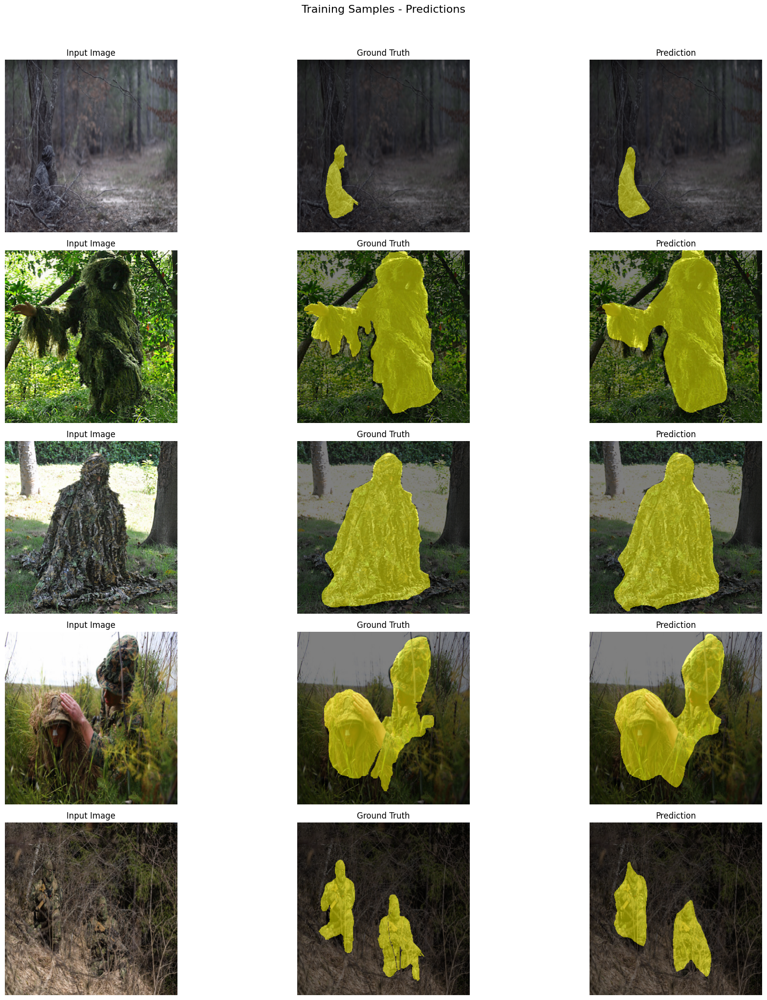

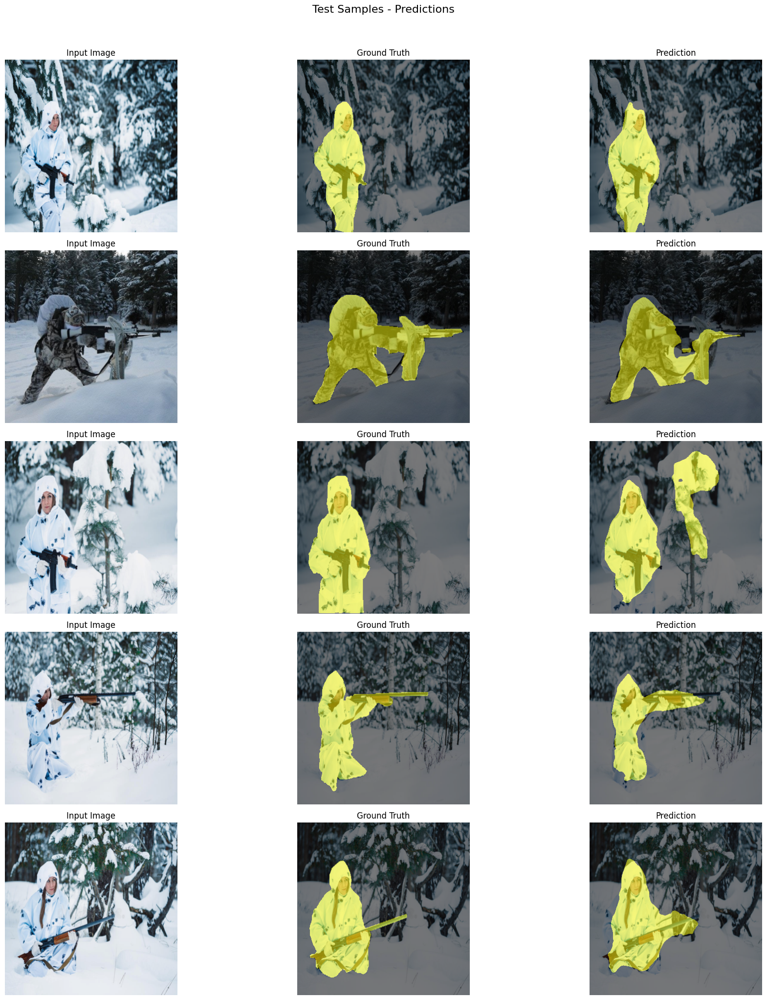

In [ ]:
import random
import numpy as np
import matplotlib.pyplot as plt
import torch
from torchvision import transforms

def overlay_mask(image, mask, color=(255, 255, 0), alpha=0.5):
    """Overlay a mask on an image with transparency."""
    mask = (mask > 0.5).astype(np.uint8)  # Binarize mask
    overlay = np.zeros_like(image)
    overlay[mask == 1] = color  # Apply yellow mask
    return (image * (1 - alpha) + overlay * alpha).astype(np.uint8)
def visualize_acanet_outputs(loader, model, title, num_samples=3):
    model.eval()
    
    # Get random batch - now handles 3 outputs
    batch = next(iter(loader))
    if len(batch) == 3:  # images, masks, edges
        images, masks, _ = batch
    else:  # images, masks
        images, masks = batch
    
    # Select random samples from batch
    indices = random.sample(range(len(images)), min(num_samples, len(images)))
    images = images[indices].cuda()
    masks = masks[indices].cuda()
    
    with torch.no_grad():
        # Get model outputs
        out, ra_out, edge_out, _ = model(images)
        out = torch.sigmoid(out).cpu().numpy().squeeze()
        ra_out = torch.sigmoid(ra_out).cpu().numpy().squeeze()
        edge_out = torch.sigmoid(edge_out).cpu().numpy().squeeze()
    
    # Convert to numpy
    images_np = images.cpu().numpy().transpose(0, 2, 3, 1)  # (B, H, W, C)
    masks_np = masks.cpu().numpy().squeeze()
    
    # Denormalize images
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    images_np = np.clip(images_np * std + mean, 0, 1) * 255  # Convert to 0-255 range
    images_np = images_np.astype(np.uint8)
    
    # Plot with 4 columns
    fig, axes = plt.subplots(num_samples, 3, figsize=(20, 4 * num_samples))
    fig.suptitle(title, fontsize=16, y=1.02)
    
    if num_samples == 1:
        axes = axes[np.newaxis, :]
    
    for i in range(num_samples):
        # Original image
        axes[i, 0].imshow(images_np[i])
        axes[i, 0].set_title("Input Image")
        axes[i, 0].axis('off')
        
        # Ground truth mask overlayed
        overlay_gt = overlay_mask(images_np[i], masks_np[i])
        axes[i, 1].imshow(overlay_gt)
        axes[i, 1].set_title("Ground Truth")
        axes[i, 1].axis('off')
        
        # Main output overlayed
        overlay_main = overlay_mask(images_np[i], out[i])
        axes[i, 2].imshow(overlay_main)
        axes[i, 2].set_title("Prediction")
        axes[i, 2].axis('off')
        
        # # Edge detection output
        # axes[i, 3].imshow(edge_out[i], cmap='gray')
        # axes[i, 3].set_title("Edge Detection")
        # axes[i, 3].axis('off')
    
    plt.tight_layout()
    plt.show()

# Visualize training samples
visualize_acanet_outputs(train_loader, model, "Training Samples - Predictions", num_samples=5)

# Visualize test samples
visualize_acanet_outputs(test_loader, model, "Test Samples - Predictions", num_samples=5)

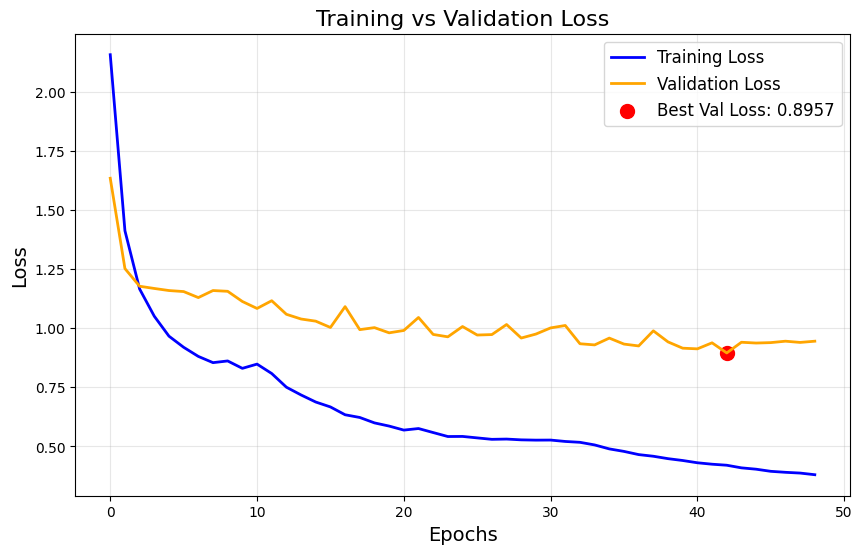

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# 1. Training and Validation Loss Curve
def plot_loss_curves(train_losses, val_losses):
    plt.figure(figsize=(10, 6))
    plt.plot(train_losses, label='Training Loss', color='blue', linewidth=2)
    plt.plot(val_losses, label='Validation Loss', color='orange', linewidth=2)
    plt.title('Training vs Validation Loss', fontsize=16)
    plt.xlabel('Epochs', fontsize=14)
    plt.ylabel('Loss', fontsize=14)
    plt.legend(fontsize=12)
    plt.grid(True, alpha=0.3)
    
    # Mark the best validation loss point
    best_val_epoch = val_losses.index(min(val_losses))
    plt.scatter(best_val_epoch, min(val_losses), color='red', s=100, 
                label=f'Best Val Loss: {min(val_losses):.4f}')
    plt.legend(fontsize=12)
    
    plt.show()

# Extract the loss values from your training log
train_losses = [
    2.1580, 1.4130, 1.1664, 1.0511, 0.9667, 0.9196, 0.8810, 0.8546, 0.8618, 0.8305,
    0.8484, 0.8086, 0.7507, 0.7178, 0.6879, 0.6671, 0.6340, 0.6225, 0.5996, 0.5861,
    0.5691, 0.5757, 0.5587, 0.5419, 0.5423, 0.5361, 0.5300, 0.5311, 0.5278, 0.5266,
    0.5269, 0.5210, 0.5174, 0.5063, 0.4895, 0.4789, 0.4654, 0.4584, 0.4482, 0.4404,
    0.4308, 0.4247, 0.4204, 0.4093, 0.4036, 0.3946, 0.3904, 0.3872, 0.3802
]

val_losses = [
    1.6351, 1.2528, 1.1780, 1.1686, 1.1598, 1.1555, 1.1300, 1.1598, 1.1566, 1.1135,
    1.0840, 1.1167, 1.0593, 1.0393, 1.0302, 1.0035, 1.0917, 0.9943, 1.0028, 0.9808,
    0.9908, 1.0458, 0.9740, 0.9639, 1.0075, 0.9715, 0.9734, 1.0160, 0.9588, 0.9756,
    1.0016, 1.0119, 0.9346, 0.9297, 0.9585, 0.9332, 0.9253, 0.9893, 0.9424, 0.9158,
    0.9130, 0.9385, 0.8957, 0.9409, 0.9376, 0.9394, 0.9454, 0.9402, 0.9454
]

plot_loss_curves(train_losses, val_losses)

MAE:  0.0741


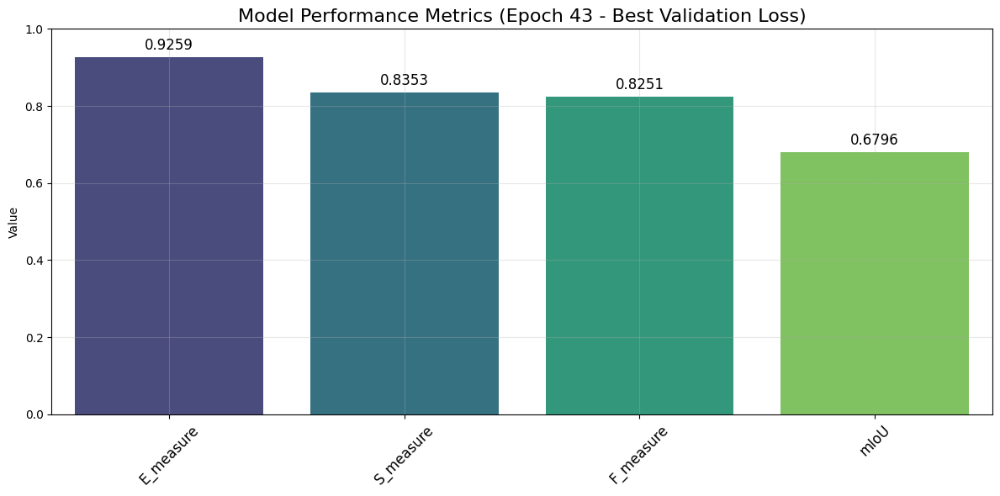

In [ ]:
# 2. Performance Metrics Bar Plot
def plot_metrics(metrics):
    
    metrics_df = pd.DataFrame.from_dict(metrics, orient='index', columns=['Value'])
    metrics_df = metrics_df.sort_values(by='Value', ascending=False)
    
    plt.figure(figsize=(12, 6))
    ax = sns.barplot(x=metrics_df.index, y='Value', data=metrics_df, palette='viridis')
    plt.title('Model Performance Metrics (Epoch 43 - Best Validation Loss)', fontsize=16)
    plt.ylim(0, 1)
    
    # Add values on top of bars
    for p in ax.patches:
        ax.annotate(f"{p.get_height():.4f}", 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha='center', va='center', 
                   xytext=(0, 10), 
                   textcoords='offset points',
                   fontsize=12)
    
    plt.xticks(rotation=45, fontsize=12)
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

# Updated metrics from Epoch 43 (best validation loss)
metrics = {
    'mIoU': 0.6796,
    'S_measure': 0.8353,
    'E_measure': 0.9259,
    'F_measure': 0.8251,
    'MAE': 0.0741
}

# Since MAE is an error metric (lower is better), we'll show it separately
positive_metrics = {k:v for k,v in metrics.items() if k != 'MAE'}
error_metric = {'MAE': metrics['MAE']}
print('MAE: ', error_metric['MAE'])

# Plot positive metrics (higher is better)
plot_metrics(positive_metrics)



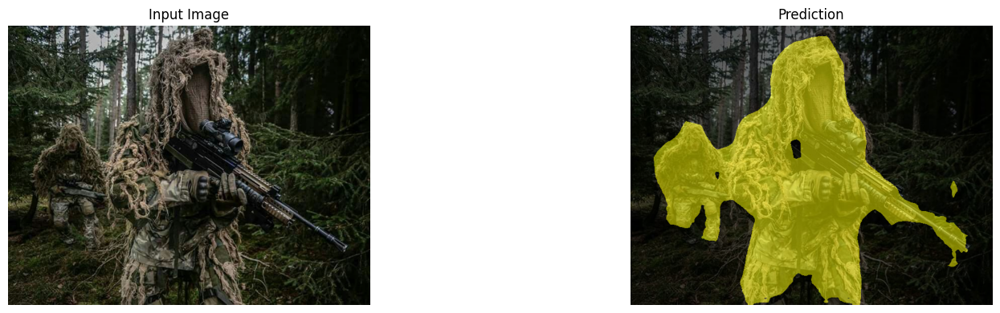

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import torch
from torchvision import transforms
from PIL import Image

def overlay_mask(image, mask, color=(255, 255, 0), alpha=0.5):
    """Overlay a resized mask on an image with transparency."""
    mask = (mask > 0.5).astype(np.uint8)  # Binarize mask
    
    # Resize mask to match the image shape
    mask_resized = cv2.resize(mask, (image.shape[1], image.shape[0]), interpolation=cv2.INTER_NEAREST)
    
    overlay = np.zeros_like(image)
    overlay[mask_resized == 1] = color  # Apply yellow mask
    
    return (image * (1 - alpha) + overlay * alpha).astype(np.uint8)

def preprocess_image(image_path):
    """Preprocess external image for model input."""
    transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    image = Image.open(image_path).convert("RGB")
    image = transform(image).unsqueeze(0).cuda()
    return image

def preprocess_mask(mask_path):
    """Preprocess external mask image."""
    mask = Image.open(mask_path).convert("L")  # Convert to grayscale
    mask = np.array(mask) / 255.0  # Normalize to [0,1]
    return mask

def visualize_acanet_external(image_path, mask_path, model):
    model.eval()
    
    # Preprocess input image and mask
    image = preprocess_image(image_path)
    mask = preprocess_mask(mask_path)
    
    with torch.no_grad():
        # Get model outputs
        out, ra_out, _, _ = model(image)
        out = torch.sigmoid(out).cpu().numpy().squeeze()
        ra_out = torch.sigmoid(ra_out).cpu().numpy().squeeze()
    
    # Convert image to numpy
    image_np = image.cpu().numpy().squeeze().transpose(1, 2, 0)
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    image_np = np.clip(image_np * std + mean, 0, 1) * 255  # Convert to 0-255 range
    image_np = image_np.astype(np.uint8)
    
    # Plot with 4 columns
    fig, axes = plt.subplots(1, 2, figsize=(18, 4))
    
    # Original image
    axes[0].imshow(image_np)
    axes[0].set_title("Input Image")
    axes[0].axis('off')
    
    # # Ground truth mask overlayed
    # overlay_gt = overlay_mask(image_np, mask)
    # axes[1].imshow(overlay_gt)
    # axes[1].set_title("Ground Truth")
    # axes[1].axis('off')
    
    # Main output overlayed
    overlay_main = overlay_mask(image_np, out)
    axes[1].imshow(overlay_main)
    axes[1].set_title("Prediction")
    axes[1].axis('off')
    
    # # Reverse attention output overlayed
    # overlay_ra = overlay_mask(image_np, ra_out)
    # axes[3].imshow(overlay_ra)
    # axes[3].set_title("Reverse Attention Overlay")
    # axes[3].axis('off')
    
    plt.tight_layout()
    plt.show()

# Example usage
visualize_acanet_external("/kaggle/input/example1/image11.jpg", "/kaggle/input/example1/image11 (1).jpg", model)


In [73]:
import os
import numpy as np
import torch
import matplotlib.pyplot as plt
from PIL import Image
import albumentations as A
from albumentations.pytorch import ToTensorV2
from torch import nn

def plot_predictions_with_yellow_overlay(model, image_paths, train_mask_dir, test_mask_dir, device, title_prefix="Sample"):
    model.eval()

    transform = A.Compose([
        A.Resize(352, 352),
        A.Normalize(),
        ToTensorV2()
    ])

    plt.figure(figsize=(12, 4 * len(image_paths)))

    for i, image_path in enumerate(image_paths):
        mask_dir = train_mask_dir if "Train" in image_path else test_mask_dir
        mask_filename = os.path.basename(image_path).replace(".jpg", ".png")
        mask_path = os.path.join(mask_dir, mask_filename)

        if not os.path.exists(mask_path):
            print(f"Warning: Mask file not found for {image_path}, skipping...")
            continue

        # Load and resize image
        image = Image.open(image_path).convert("RGB").resize((352, 352))
        image_np = np.array(image)

        # Transform for prediction
        augmented = transform(image=image_np)
        image_tensor = augmented['image'].unsqueeze(0).to(device)

        # Model prediction
        with torch.no_grad():
            pred, _ = model(image_tensor)
            pred = nn.functional.interpolate(pred, size=(352, 352), mode="bilinear", align_corners=False)
            pred = (pred > 0.5).float().squeeze().cpu().numpy()

        # Load and resize GT mask
        gt_mask = Image.open(mask_path).convert("L").resize((352, 352), Image.NEAREST)
        gt_mask_np = np.array(gt_mask) / 255.0

        # Yellow overlay creation
        def create_yellow_overlay(mask):
            overlay = np.zeros((352, 352, 3), dtype=np.uint8)
            overlay[mask == 1] = [255, 255, 0]
            return overlay

        gt_overlay = create_yellow_overlay(gt_mask_np)
        pred_overlay = create_yellow_overlay(pred)

        # Plot original image
        plt.subplot(len(image_paths), 3, 3*i + 1)
        plt.imshow(image_np)
        plt.title(f"{title_prefix} Image {i+1}")
        plt.axis("off")

        # Plot GT with overlay
        plt.subplot(len(image_paths), 3, 3*i + 2)
        plt.imshow(image_np)
        plt.imshow(gt_overlay, alpha=0.5)
        plt.title("Ground Truth (Yellow Overlay)")
        plt.axis("off")

        # Plot prediction with overlay
        plt.subplot(len(image_paths), 3, 3*i + 3)
        plt.imshow(image_np)
        plt.imshow(pred_overlay, alpha=0.5)
        plt.title("Prediction (Yellow Overlay)")
        plt.axis("off")

    plt.tight_layout()
    plt.show()


C:\Users\lenovo\AppData\Local\Temp\ipykernel_14172\1726746654.py:45: DeprecationWarning: NEAREST is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.NEAREST or Dither.NONE instead.
  gt_mask = Image.open(mask_path).convert("L").resize((352, 352), Image.NEAREST)


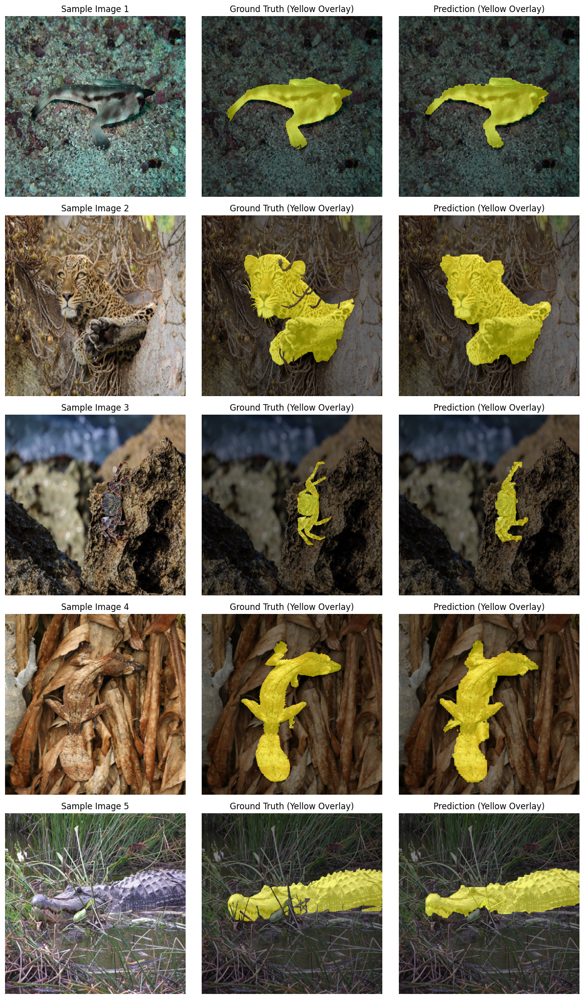

In [103]:
plot_predictions_with_yellow_overlay(model, image_paths[:5], train_mask_dir, test_mask_dir, device)


C:\Users\lenovo\AppData\Local\Temp\ipykernel_14172\1726746654.py:45: DeprecationWarning: NEAREST is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.NEAREST or Dither.NONE instead.
  gt_mask = Image.open(mask_path).convert("L").resize((352, 352), Image.NEAREST)


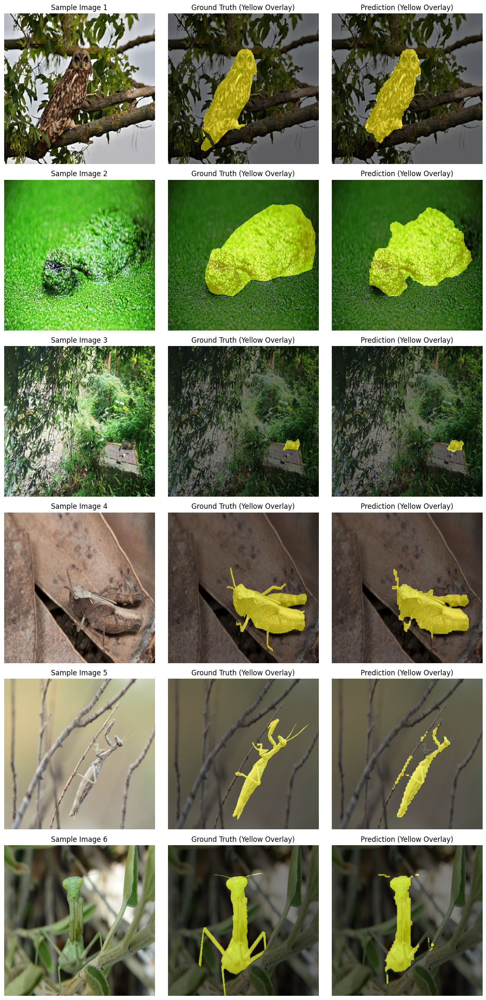

In [104]:
plot_predictions_with_yellow_overlay(model, image_paths[5:11], train_mask_dir, test_mask_dir, device)


C:\Users\lenovo\AppData\Local\Temp\ipykernel_14172\1726746654.py:45: DeprecationWarning: NEAREST is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.NEAREST or Dither.NONE instead.
  gt_mask = Image.open(mask_path).convert("L").resize((352, 352), Image.NEAREST)


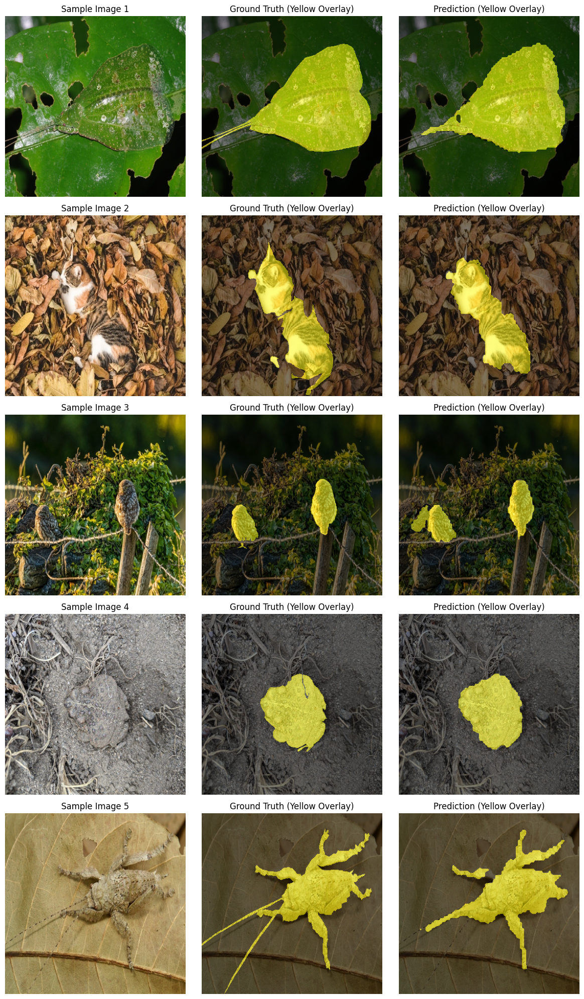

In [106]:
plot_predictions_with_yellow_overlay(model, image_paths[11:16], train_mask_dir, test_mask_dir, device)


C:\Users\lenovo\AppData\Local\Temp\ipykernel_14172\1726746654.py:45: DeprecationWarning: NEAREST is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.NEAREST or Dither.NONE instead.
  gt_mask = Image.open(mask_path).convert("L").resize((352, 352), Image.NEAREST)


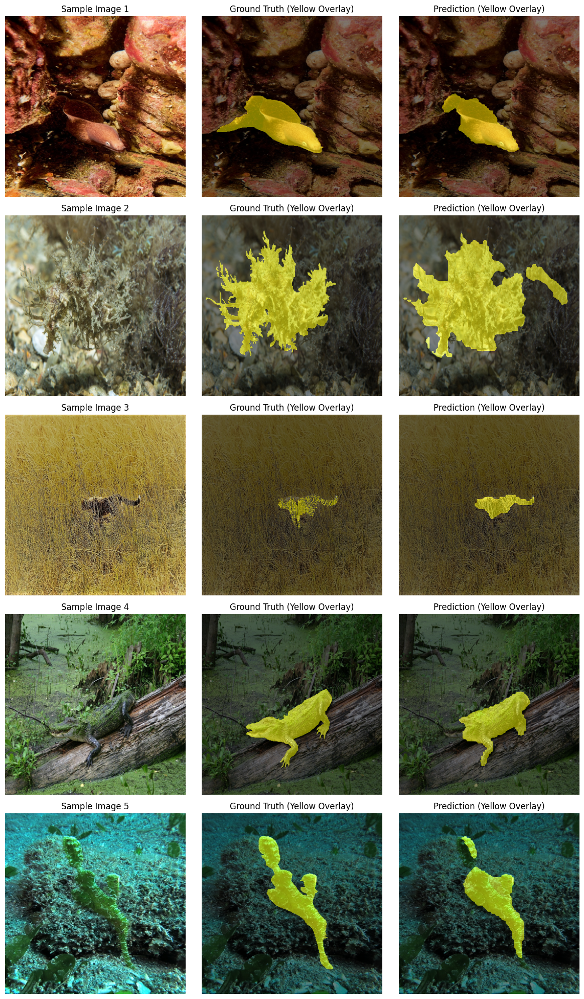

In [107]:
plot_predictions_with_yellow_overlay(model, image_paths[16:21], train_mask_dir, test_mask_dir, device)
